In [2]:
import numpy as np
import pandas as pd
import seaborn as sb
import geopandas
import squidpy as sq
import scanpy as sc
import spatialdata
import matplotlib.pyplot as plt

/Users/u0128760/opt/anaconda3/lib/python3.9/site-packages/geopandas/_compat.py:123: UserWarning: The Shapely GEOS version (3.11.1-CAPI-1.17.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(
/var/folders/rk/0rnwtpxx53j_nv5l3xtmz0792832ql/T/ipykernel_92955/3156548414.py:4: UserWarning: Shapely 2.0 is installed, but because PyGEOS is also installed, GeoPandas will still use PyGEOS by default for now. To force to use and test Shapely 2.0, you have to set the environment variable USE_PYGEOS=0. You can do this before starting the Python process, or in your code before importing geopandas:

import os
os.environ['USE_PYGEOS'] = '0'
import geopandas

In a future release, GeoPandas will switch to using Shapely by default. If you are using PyGEOS directly (calling PyGEOS functions on geometries from GeoPandas), this will then stop working and you are encouraged to migrate from PyGEOS to Shapely 2.0 (http

In [4]:
import sys
print("Python version:", sys.version)
print(sq.__version__)
print(sc.__version__)

Python version: 3.9.12 (main, Apr  5 2022, 01:53:17) 
[Clang 12.0.0 ]
1.2.3
1.9.3


In [2]:
#just run this cell, it is code from my package that you can use to plot things! 
def overlapping_region_2D(
    A, B
):
    overlap_x = not (A[1] < B[0] or B[1] < A[0])
    overlap_y = not (A[3] < B[2] or B[3] < A[2])

    if overlap_x and overlap_y:
        # Calculate overlapping region
        x_min = max(A[0], B[0])
        x_max = min(A[1], B[1])
        y_min = max(A[2], B[2])
        y_max = min(A[3], B[3])

        # Return as a list: [x_min, x_max, y_min, y_max]
        return [x_min, x_max, y_min, y_max]
    else:
        return None

def plot_shapes("this part of the code can't be public -availble upon request")


In [3]:
path_sdata='/MelanomaHuman1_A2-1try3/sdata.zarr'
sdata=spatialdata.read_zarr(path_sdata)

## Plot_shapes


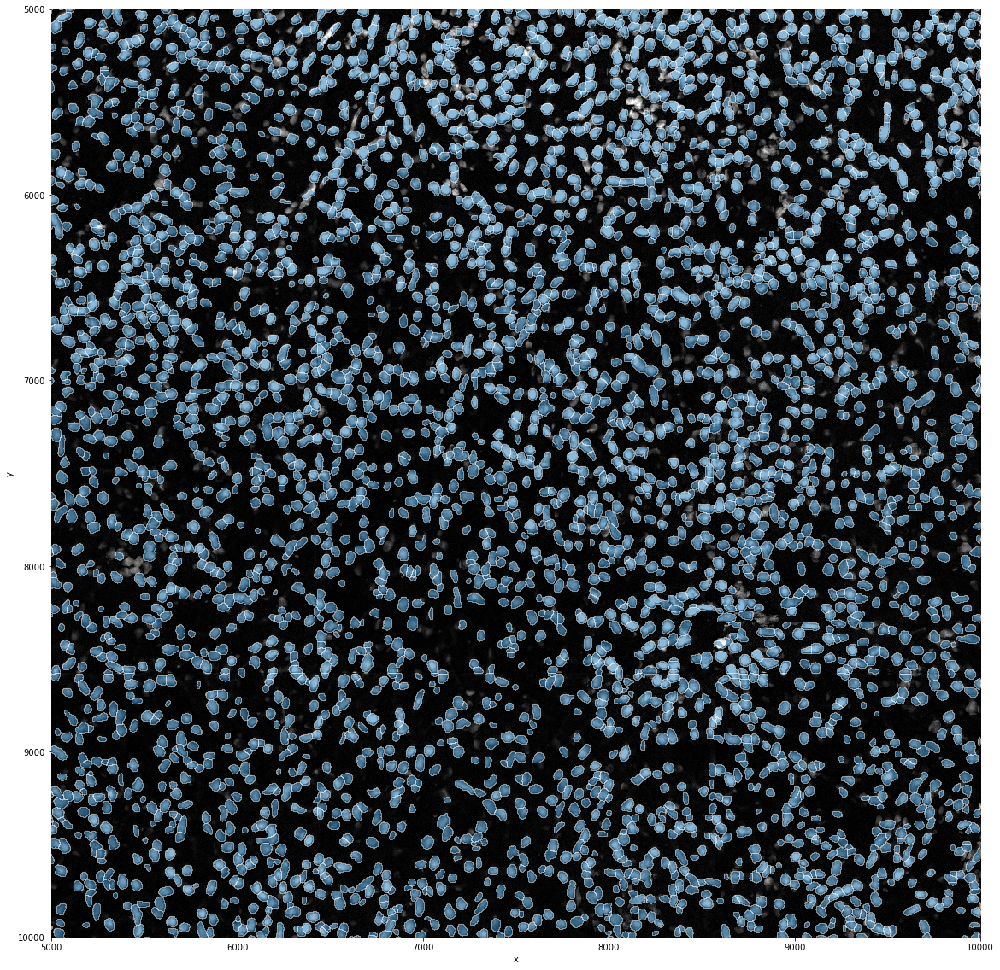

In [4]:
plot_shapes(sdata, crd=[5000,10000,5000,10000])

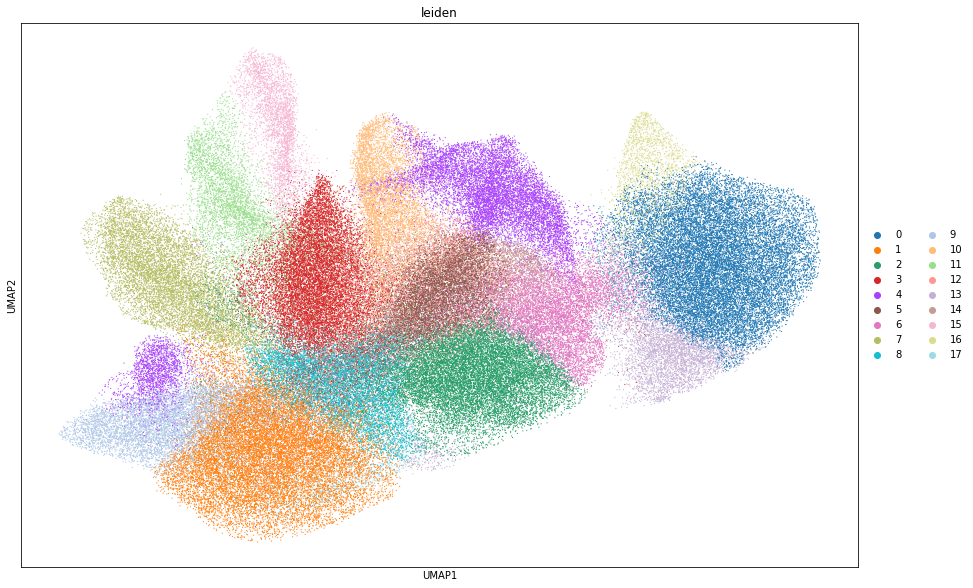

(-5.457659506797791, 17.858285212516783, -8.617524552345277, 9.65220730304718)

In [5]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(1, 1, figsize=(15, 10))
sc.pl.umap(sdata.table, color=[ 'leiden' ], ax=ax,size=800000/sdata.table.shape[0])
ax.axis("off")


## Information about data 

Now, the data is put in a spatialdata object, which means the old adata table you are used to use is hidden in sdata.table. But it is the same object! This sdata contains all types of different information, making it possible to perform the plotting!

- adata.X: normalized and scaled counts
- adata.raw.X: normalized counts 
- adata.layers['raw_counts']: raw counts
- adata.obs: general information about the cells:
    - maxscores gives the celltype annotation, however, in some cases this went completely wrong and shouldn't be trusted
    - score for every cell and every celltype: give an idea for every cell how likely it belongs to a celltype: you can compare one celltype between cells, comparing different celltypes within a cell is more difficult
- adata.var: general scores about the genes
- adata.obsm:
    - polygons: gives the geopandas shapes of the cells 
    - spatial: here the coordinates of the cells are saved
    - X_UMAP and X_PCA: infomarion about the cells location in UMAP and PCA
- adata.uns:
    - leiden and leiden colors: the clusters ad the color clusters 
    -maxscores_colors: the colors of the celltype annotation
    -spatial: inclused the cleand image: reachable thourh sdata.table.uns['spatial']['melanoma']['images']['hires']

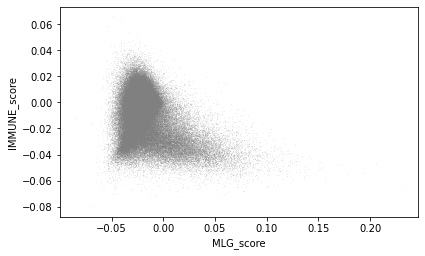

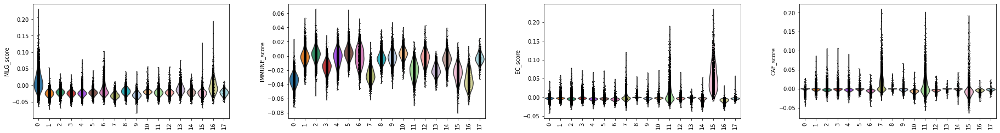

In [6]:
gene_list = ['CDH19','ERBB3','MYO10','S100A1','S100B', 'MITF', 'SOX10']
sc.tl.score_genes(sdata.table, gene_list, ctrl_size=50, gene_pool=None, n_bins=10, score_name='MLG_score', random_state=0, copy=False, use_raw=True)

gene_list = ['CD19','MS4A1','CD4','CD8A','CLEC10A','CLEC9A','PTPRC','CD163','CD68','MRC1','ITGAM','ITGAX','NCAM1','NCR1','CD3E','CTLA4','FOXP3','IL2RA','FCGR3A','CD274','GNLY','GZMB','IFNG','LAG3','PDCD1','PRF1','XCL1', 'TIGIT']
sc.tl.score_genes(sdata.table, gene_list, ctrl_size=50, gene_pool=None, n_bins=10, score_name='IMMUNE_score', random_state=0, copy=False, use_raw=True)

gene_list = ['AQP1','CD34','KDR','PECAM1','LYVE1','PROX1','ACTA2','RGS5','VWF', 'TFF3']
sc.tl.score_genes(sdata.table, gene_list, ctrl_size=50, gene_pool=None, n_bins=10, score_name='EC_score', random_state=0, copy=False, use_raw=True)

gene_list = ['THY1','POSTN','PDGFRB', 'LUM']
sc.tl.score_genes(sdata.table, gene_list, ctrl_size=50, gene_pool=None, n_bins=10, score_name='CAF_score', random_state=0, copy=False, use_raw=True)

sc.pl.scatter(sdata.table,'MLG_score', 'IMMUNE_score')
sc.pl.violin(sdata.table, keys=['MLG_score','IMMUNE_score','EC_score', 'CAF_score'], groupby='leiden', rotation=90)



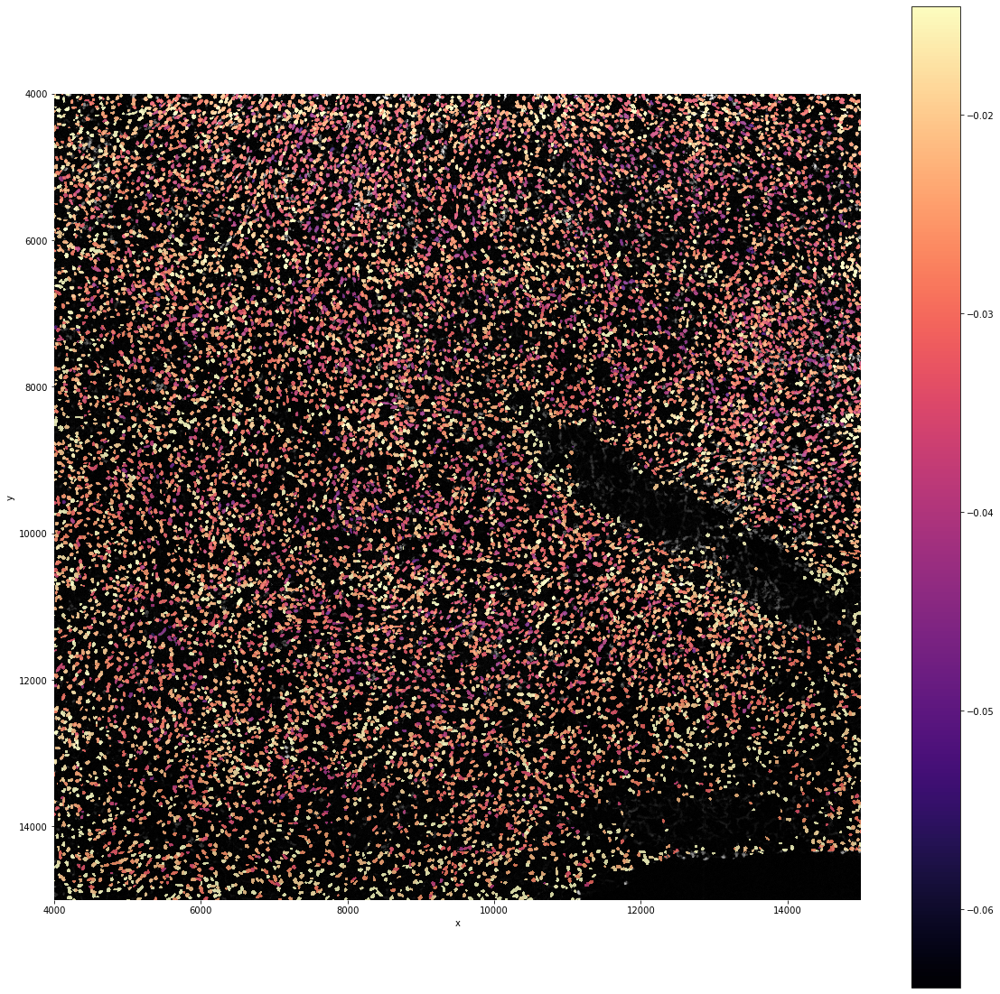

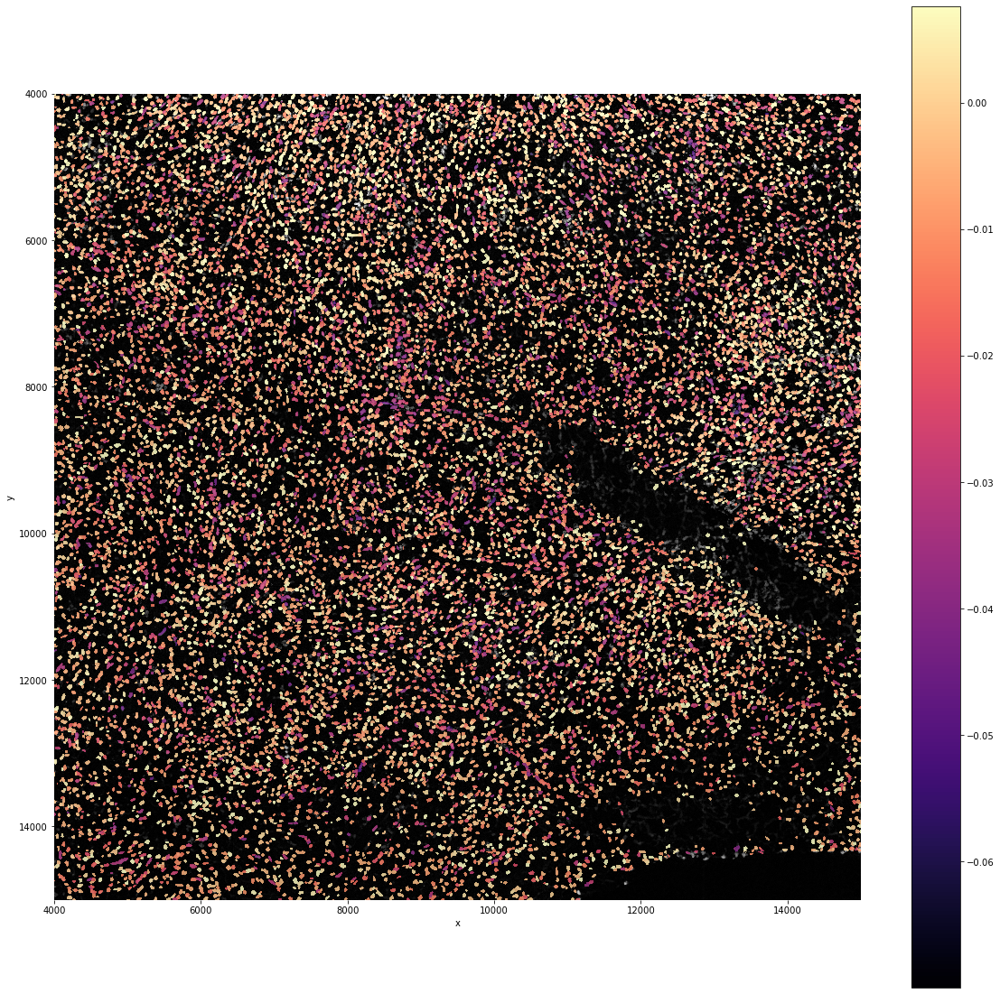

In [7]:
import matplotlib
crd=[4000,15000,4000,15000]
plot_shapes(sdata,column='MLG_score',crd=crd,alpha=0.8,vmax=90)
plot_shapes(sdata,column='IMMUNE_score',crd=crd,alpha=0.8,vmax=90)

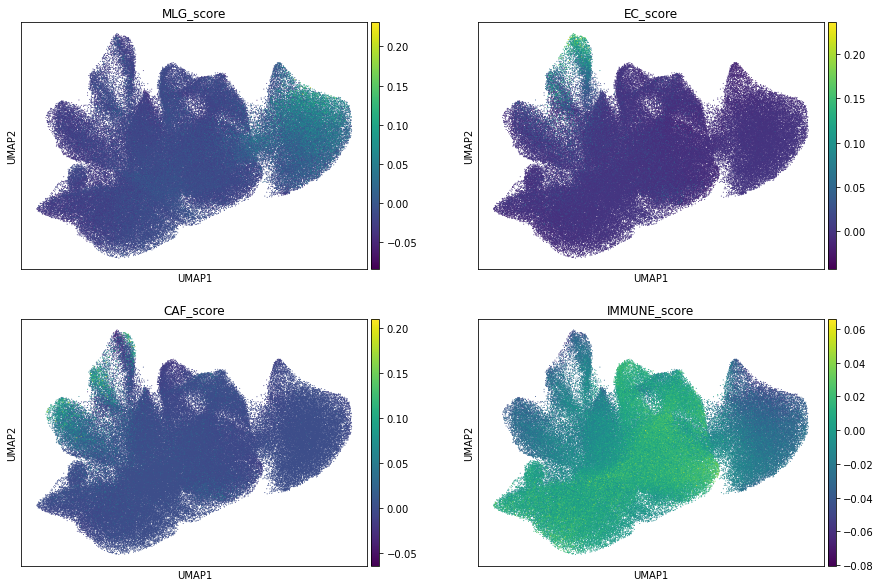

In [8]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(2, 2, figsize=(15, 10))
sc.pl.umap(sdata.table, color=[ 'MLG_score' ], ax=ax[0,0],size=600000/sdata.table.shape[0],show=False)
sc.pl.umap(sdata.table, color=[ 'EC_score' ], ax=ax[0,1],size=600000/sdata.table.shape[0],show=False)
sc.pl.umap(sdata.table, color=[ 'CAF_score' ], ax=ax[1,0],size=600000/sdata.table.shape[0],show=False)
sc.pl.umap(sdata.table, color=[ 'IMMUNE_score' ], ax=ax[1,1],size=600000/sdata.table.shape[0],show=False)
plt.show()


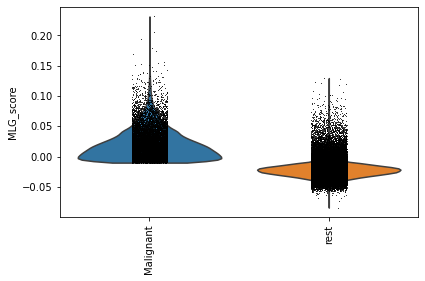

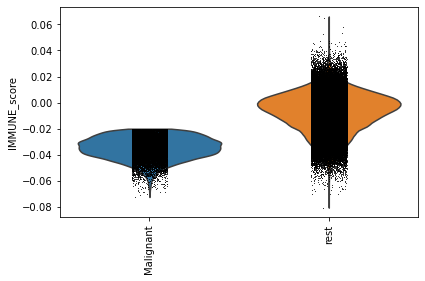

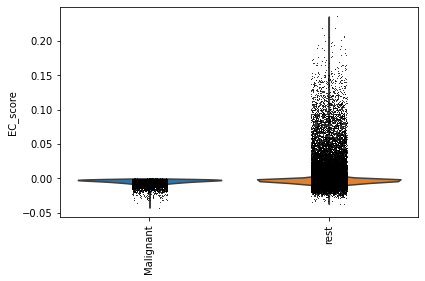

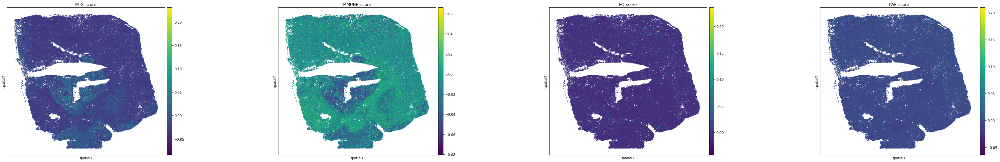

In [9]:
sdata.table.obs['MALIGNANT'] = np.where((sdata.table.obs['MLG_score'] > -0.01) & (sdata.table.obs['IMMUNE_score']< -0.02) & (sdata.table.obs['EC_score']< 0), 'Malignant', 'rest')

sc.pl.violin(sdata.table, keys=['MLG_score'], groupby='MALIGNANT', rotation=90)
sc.pl.violin(sdata.table, keys=['IMMUNE_score'], groupby='MALIGNANT', rotation=90)
sc.pl.violin(sdata.table, keys=['EC_score'], groupby='MALIGNANT', rotation=90)

sq.pl.spatial_scatter(
    sdata.table,
    color=['MLG_score', 'IMMUNE_score', 'EC_score', 'CAF_score'],
    size=2,
    #cmap='Reds',
    img=False,
    shape=None,
    figsize=(12, 8)
)


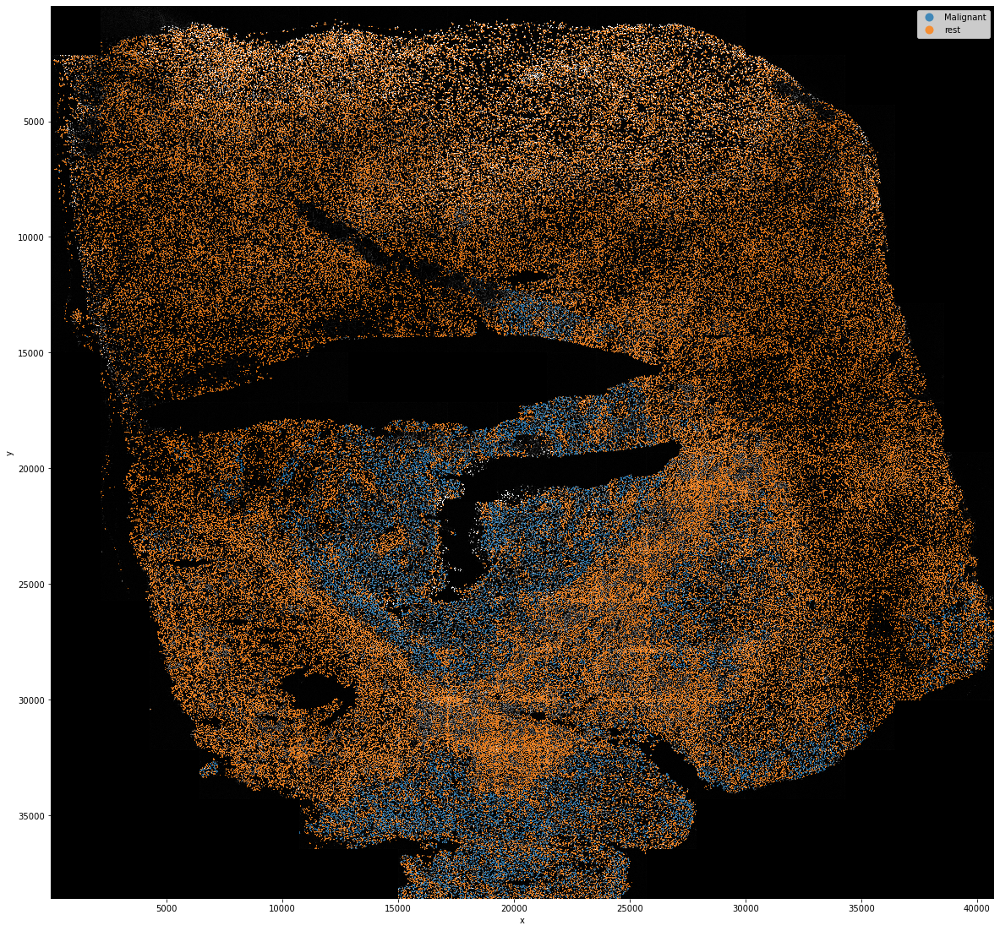

In [10]:
crd=[0,20000,0,20000]
plot_shapes(sdata,column='MALIGNANT',alpha=0.8)

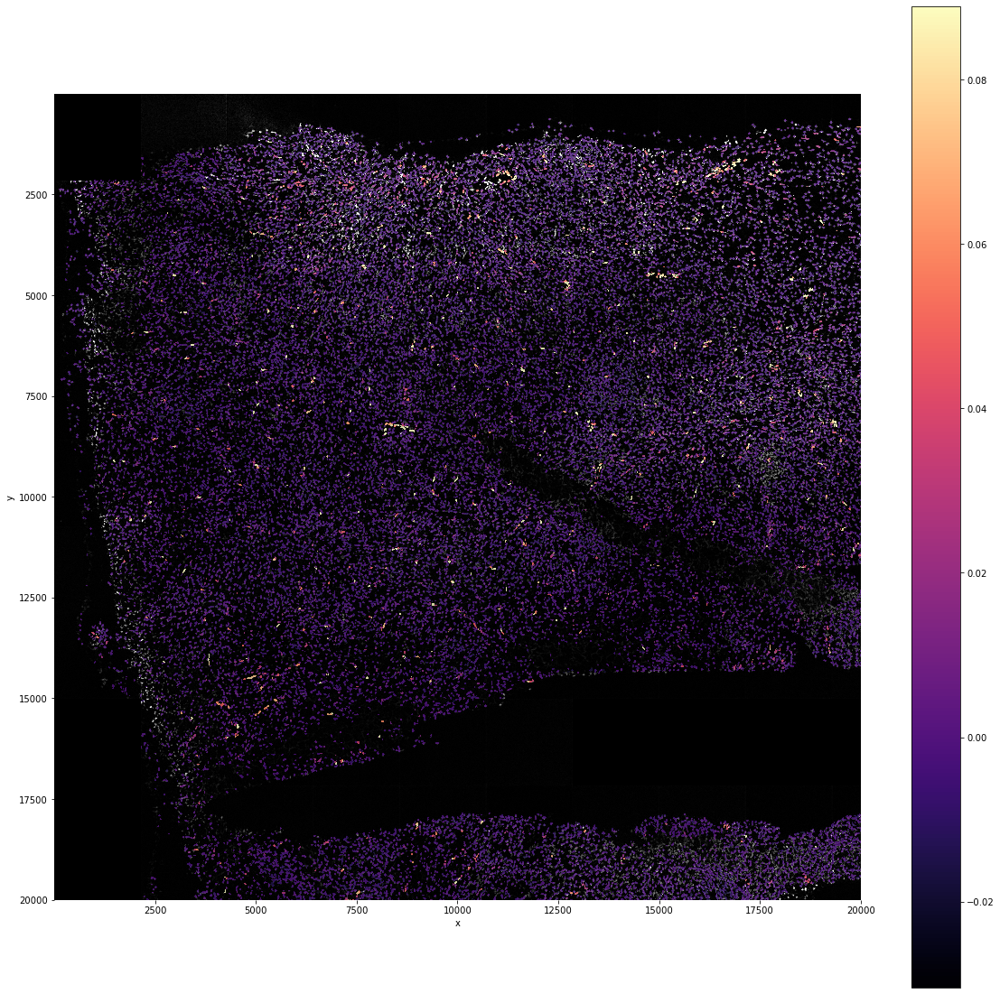

In [11]:
plot_shapes(sdata,column='EC_score',crd=crd,alpha=0.8,vmax=99)

In [12]:
#subset malignant cells

MALIGNANT =sdata.table[sdata.table.obs.MALIGNANT == 'Malignant']
MALIGNANT.uns['log1p']["base"] = 2


neighbors


/Users/u0128760/opt/anaconda3/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/u0128760/opt/anaconda3/lib/python3.9/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/u0128760/opt/anaconda3/lib/python3.9/site-packages/umap/distances.py:1086: 

UMAP
Leiden


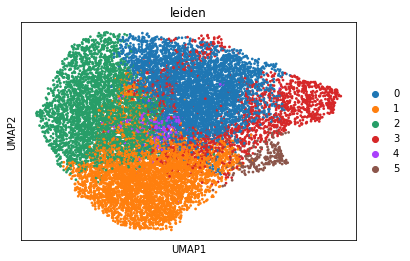

In [13]:
resolution = 0.2
print('neighbors')
sc.pp.neighbors(MALIGNANT, n_neighbors=6, n_pcs=17)
print('UMAP')
sc.tl.umap(MALIGNANT)
print('Leiden')
sc.tl.leiden(MALIGNANT, resolution=resolution)
sc.pl.umap(MALIGNANT, color=['leiden'], size=30)


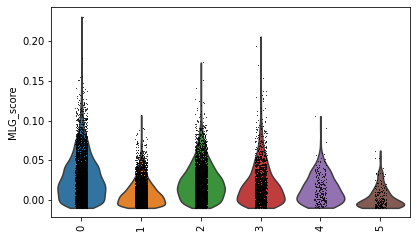

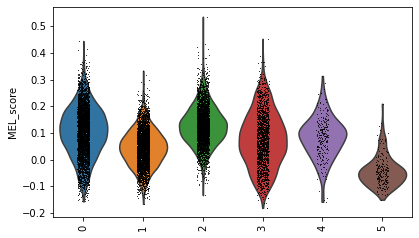

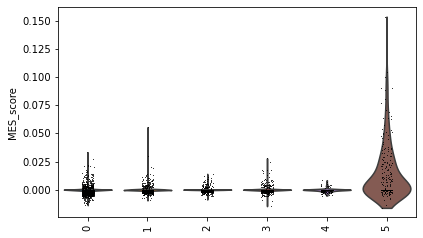

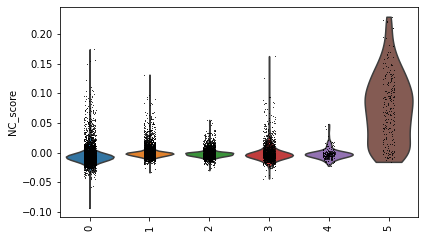

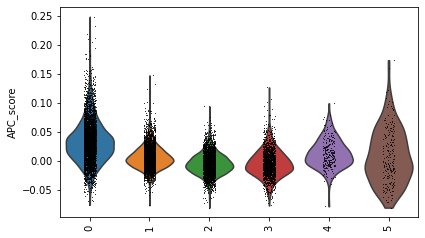

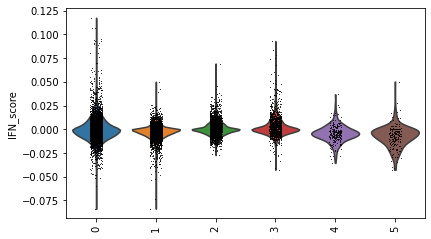

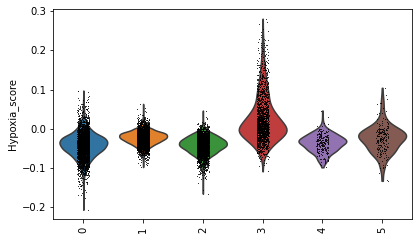

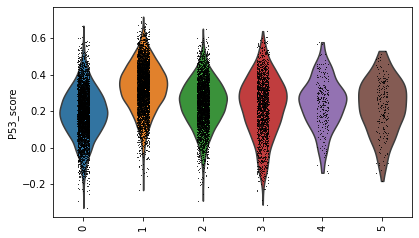

In [15]:
gene_list = ['DCN','ID3','PDGFRB','PRRX1','TCF4','COL1A1','COL5A1','THY1', 'POSTN', 'LUM']
sc.tl.score_genes(MALIGNANT, gene_list, ctrl_size=len(gene_list), gene_pool=None, n_bins=25, score_name='MES_score', random_state=0, copy=False, use_raw=True)

gene_list = ['FN1','FREM2','ITGB8','NGFR','NT5E','TNC', 'TEAD1', 'AXL']
sc.tl.score_genes(MALIGNANT, gene_list, ctrl_size=len(gene_list), gene_pool=None, n_bins=25, score_name='NC_score', random_state=0, copy=False, use_raw=True)

gene_list = ["B2M","CD74","CIITA","GBP1","HLA-B","HLA-DRA","STAT1","TAP1", "NLRC5"]
sc.tl.score_genes(MALIGNANT, gene_list, ctrl_size=len(gene_list), gene_pool=None, n_bins=25, score_name='APC_score', random_state=0, copy=False, use_raw=True)

gene_list = ["MITF","MLANA","MYC","PMEL","SOX10","TYRP1","COX5A"]
sc.tl.score_genes(MALIGNANT, gene_list, ctrl_size=len(gene_list), gene_pool=None, n_bins=25, score_name='MEL_score', random_state=0, copy=False, use_raw=True)

gene_list = ["IFIT1","LGI3","MX1","PKHD1","SEMA3D", "APCDD1", "CSPG5"]
sc.tl.score_genes(MALIGNANT, gene_list, ctrl_size=len(gene_list), gene_pool=None, n_bins=25, score_name='IFN_score', random_state=0, copy=False, use_raw=True)

gene_list = ['BNIP3L','ENO2','PDK1','VEGFA']
sc.tl.score_genes(MALIGNANT, gene_list, ctrl_size=len(gene_list), gene_pool=None, n_bins=25, score_name='Hypoxia_score', random_state=0, copy=False, use_raw=True)


gene_list = ['FUS','MALAT1','NEAT1','SON']
sc.tl.score_genes(MALIGNANT, gene_list, ctrl_size=len(gene_list), gene_pool=None, n_bins=25, score_name='P53_score', random_state=0, copy=False, use_raw=True)

sc.pl.violin(MALIGNANT, keys=['MLG_score'], groupby='leiden', rotation=90)
sc.pl.violin(MALIGNANT, keys=['MEL_score'], groupby='leiden', rotation=90)
sc.pl.violin(MALIGNANT, keys=['MES_score'], groupby='leiden', rotation=90)
sc.pl.violin(MALIGNANT, keys=['NC_score'], groupby='leiden', rotation=90)
sc.pl.violin(MALIGNANT, keys=['APC_score'], groupby='leiden', rotation=90)
sc.pl.violin(MALIGNANT, keys=['IFN_score'], groupby='leiden', rotation=90)
sc.pl.violin(MALIGNANT, keys=['Hypoxia_score'], groupby='leiden', rotation=90)
sc.pl.violin(MALIGNANT, keys=['P53_score'], groupby='leiden', rotation=90)



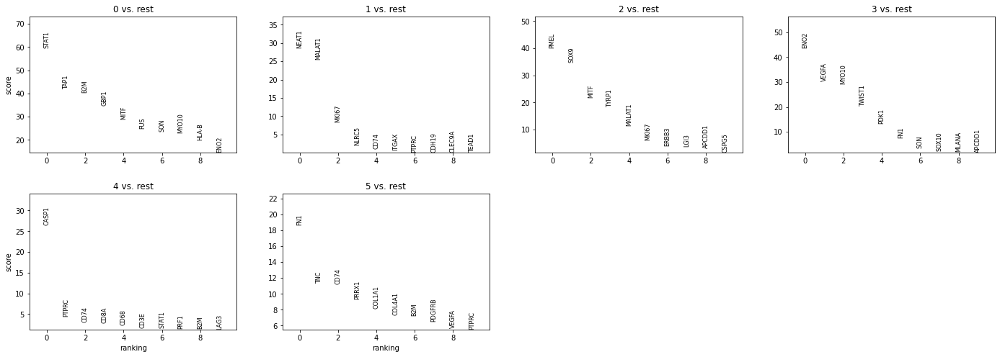

In [16]:
sc.tl.rank_genes_groups(MALIGNANT, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(MALIGNANT, n_genes=10, sharey=False)


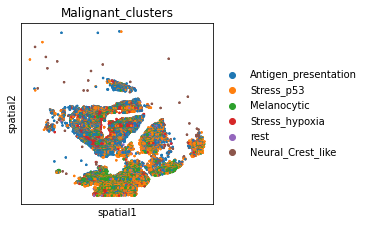

In [18]:
old_to_new = {'1':'Stress_p53', '0':'Antigen_presentation', '2':'Melanocytic', '3':'Stress_hypoxia', '4':'rest', '5':'Neural_Crest_like'}

MALIGNANT.obs['Malignant_clusters'] = (
    MALIGNANT.obs['leiden']
    .map(old_to_new)
    .astype('category')
)
sq.pl.spatial_scatter(
    MALIGNANT,
    color=['Malignant_clusters'],
    size=8,
    cmap='Reds',
    shape=None,
    img=False,
    figsize=(5, 5)
)

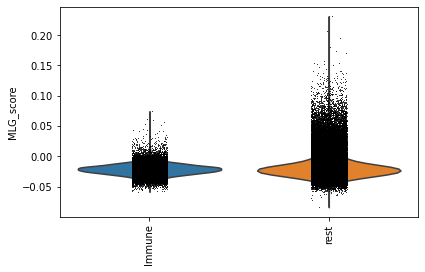

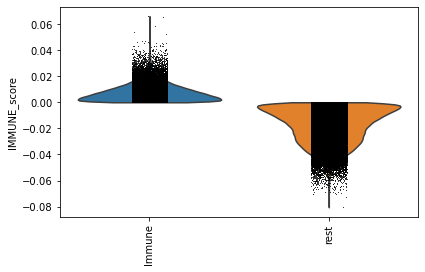

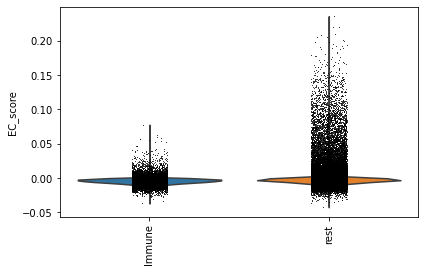

neighbors
UMAP
Leiden


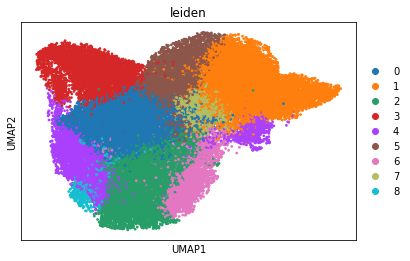

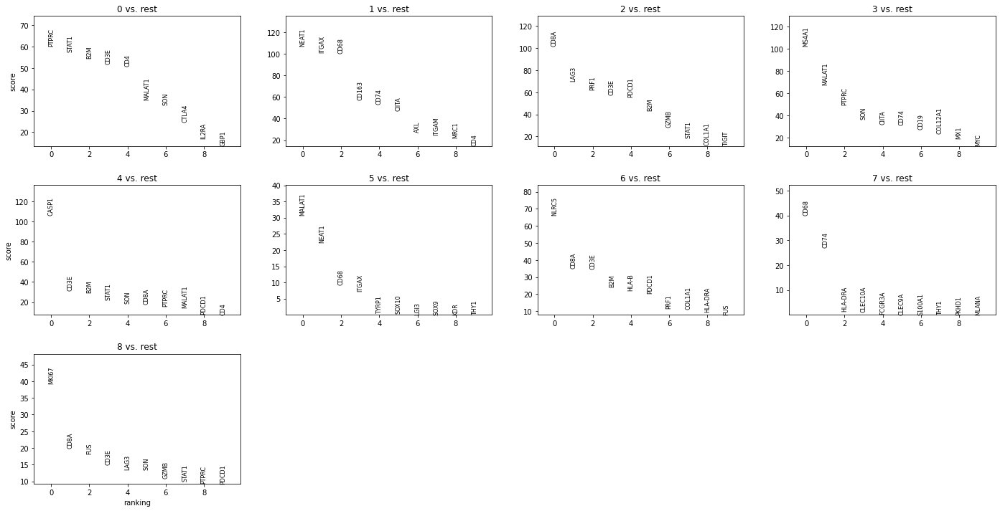

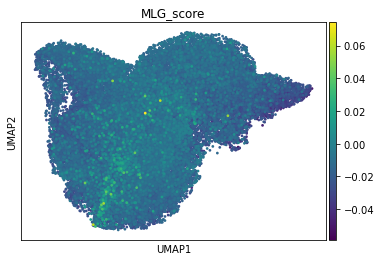

In [19]:
###### IMMUNE CELLS
sdata.table.obs['IMMUNE'] = np.where((sdata.table.obs['IMMUNE_score'] > 0), 'Immune', 'rest')

sc.pl.violin(sdata.table, keys=['MLG_score'], groupby='IMMUNE', rotation=90)
sc.pl.violin(sdata.table, keys=['IMMUNE_score'], groupby='IMMUNE', rotation=90)
sc.pl.violin(sdata.table, keys=['EC_score'], groupby='IMMUNE', rotation=90)

##### subset and normalize
IMMUNE =sdata.table[sdata.table.obs.IMMUNE == 'Immune']
IMMUNE.uns['log1p']["base"] = None


### cluster
resolution = 0.4
print('neighbors')
sc.pp.neighbors(IMMUNE, n_neighbors=6, n_pcs=15)
print('UMAP')
sc.tl.umap(IMMUNE)
print('Leiden')
sc.tl.leiden(IMMUNE, resolution=resolution)
sc.pl.umap(IMMUNE, color=['leiden'], size=30)


#### marker genes
sc.tl.rank_genes_groups(IMMUNE, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(IMMUNE, n_genes=10, sharey=False)
#IMMUNE.obs['leiden'] = IMMUNE.obs['leiden'].astype(str) + '_immune'
sc.pl.umap(IMMUNE, color=['MLG_score'], size=30)



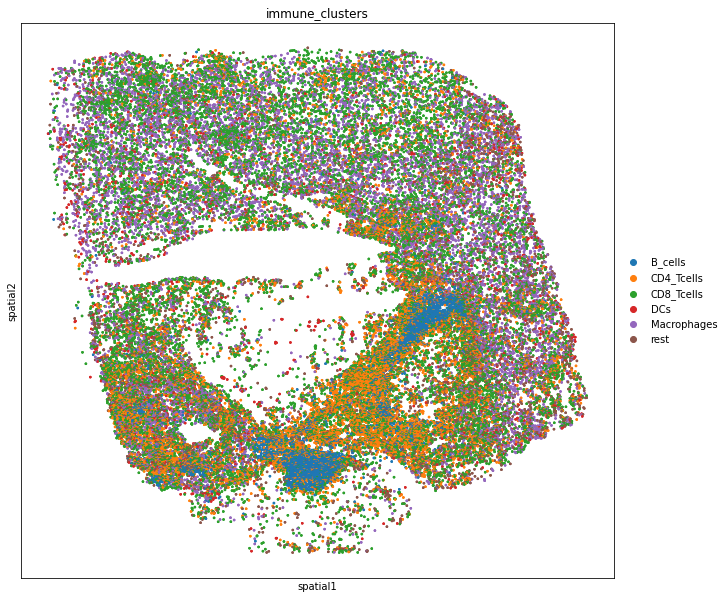

In [20]:
old_to_new = {'0':'CD4_Tcells', '1':'Macrophages', '2':'CD8_Tcells', '3': 'B_cells', '4':'CD8_Tcells', '5':'rest', '6':'CD8_Tcells', '7':'DCs', '8':'CD8_Tcells'}
IMMUNE.obs['immune_clusters'] = (
    IMMUNE.obs['leiden']
    .map(old_to_new)
    .astype('category')
)


sq.pl.spatial_scatter(
    IMMUNE,
    color=['immune_clusters'],
    size=10,
    cmap='Reds',
    img=False,
    shape=None,
    figsize=(10, 10)
)


In [21]:
sdata.table.obs['EC'] = np.where((sdata.table.obs['EC_score'] > 0.025 ), 'EC', 'rest') #0.025?
sdata.table.obs['CAF'] = np.where((sdata.table.obs['CAF_score'] > 0.05 ), 'CAF', 'rest')



In [22]:
#add malignant meta_data to entire object
sdata.table.obs['Malignant_clusters'] = MALIGNANT.obs['Malignant_clusters']

# First, add the "rest" category to the list of categories in the column
categories = list(sdata.table.obs['Malignant_clusters'].cat.categories)
if "rest" not in categories:
    categories.append("rest")
    sdata.table.obs['Malignant_clusters'] = sdata.table.obs['Malignant_clusters'].cat.set_categories(categories)

# Then, assign the values
sdata.table.obs['Malignant_clusters'] = sdata.table.obs['Malignant_clusters'].fillna("rest")

# print the result
print(sdata.table.obs['Malignant_clusters'])


#add malignant meta_data to entire object
sdata.table.obs['Immune_clusters'] = IMMUNE.obs['immune_clusters']
# First, add the "rest" category to the list of categories in the column
categories = list(sdata.table.obs['Immune_clusters'].cat.categories)
if "rest" not in categories:
    categories.append("rest")
    sdata.table.obs['Immune_clusters'] = sdata.table.obs['Immune_clusters'].cat.set_categories(categories)
# Then, assign the values
sdata.table.obs['Immune_clusters'] = sdata.table.obs['Immune_clusters'].fillna("rest")



cells
516       rest
517       rest
518       rest
519       rest
520       rest
          ... 
591088    rest
592111    rest
592623    rest
594157    rest
596202    rest
Name: Malignant_clusters, Length: 153702, dtype: category
Categories (6, object): ['Antigen_presentation', 'Stress_p53', 'Melanocytic', 'Stress_hypoxia', 'rest', 'Neural_Crest_like']


In [23]:
sdata.table.obs.columns

Index(['region', 'instance', 'n_genes_by_counts', 'log1p_n_genes_by_counts',
       'total_counts', 'log1p_total_counts', 'pct_counts_in_top_2_genes',
       'pct_counts_in_top_5_genes', 'n_counts', 'shapeSize', 'leiden',
       'MLG_score', 'IMMUNE_score', 'EC_score', 'CAF_score', 'MALIGNANT',
       'IMMUNE', 'EC', 'CAF', 'Malignant_clusters', 'Immune_clusters'],
      dtype='object')

In [24]:
sdata.table.obs.EC

cells
516       rest
517       rest
518       rest
519       rest
520       rest
          ... 
591088    rest
592111    rest
592623    rest
594157    rest
596202    rest
Name: EC, Length: 153702, dtype: object

In [25]:
def rename_columns(annot,new):
    if annot=='unknown':
        if new != 'rest':
            return new
        else: 
            return 'unknown'
    else:
        if new!= 'rest':
            return 'unknown'
        else: 
            return annot

In [26]:
#this code does what you do with all the ugly naming, but then quite a bit cleaner :D 
sdata.table.obs['annot']='unknown'
sdata.table.obs['annot']=sdata.table.obs.apply(lambda x: rename_columns(x.annot,x.Malignant_clusters),axis=1)
sdata.table.obs['annot']=sdata.table.obs.apply(lambda x: rename_columns(x.annot,x.Immune_clusters),axis=1)
sdata.table.obs['annot']=sdata.table.obs.apply(lambda x: rename_columns(x.annot,x.EC),axis=1)
sdata.table.obs['annot']=sdata.table.obs.apply(lambda x: rename_columns(x.annot,x.CAF),axis=1)

In [27]:
sdata.table.obs['annot']=sdata.table.obs['annot'].astype('category')

<AxesSubplot:>

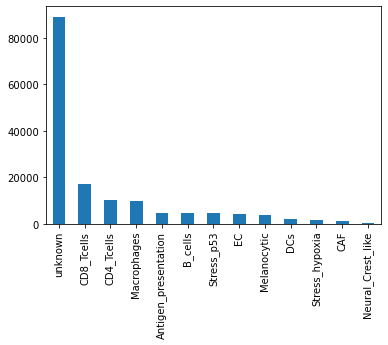

In [28]:
sdata.table.obs.annot.value_counts().plot(kind='bar')

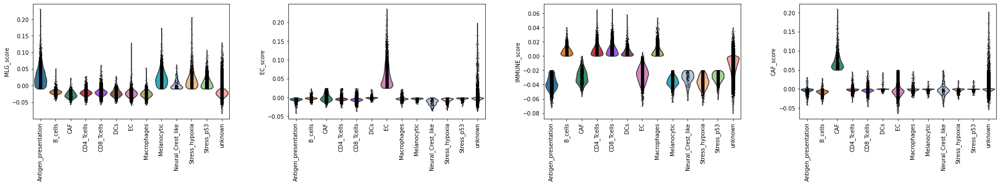

In [29]:
sc.pl.violin(sdata.table, keys = ['MLG_score','EC_score', 'IMMUNE_score', 'CAF_score'], groupby = 'annot', rotation=90)


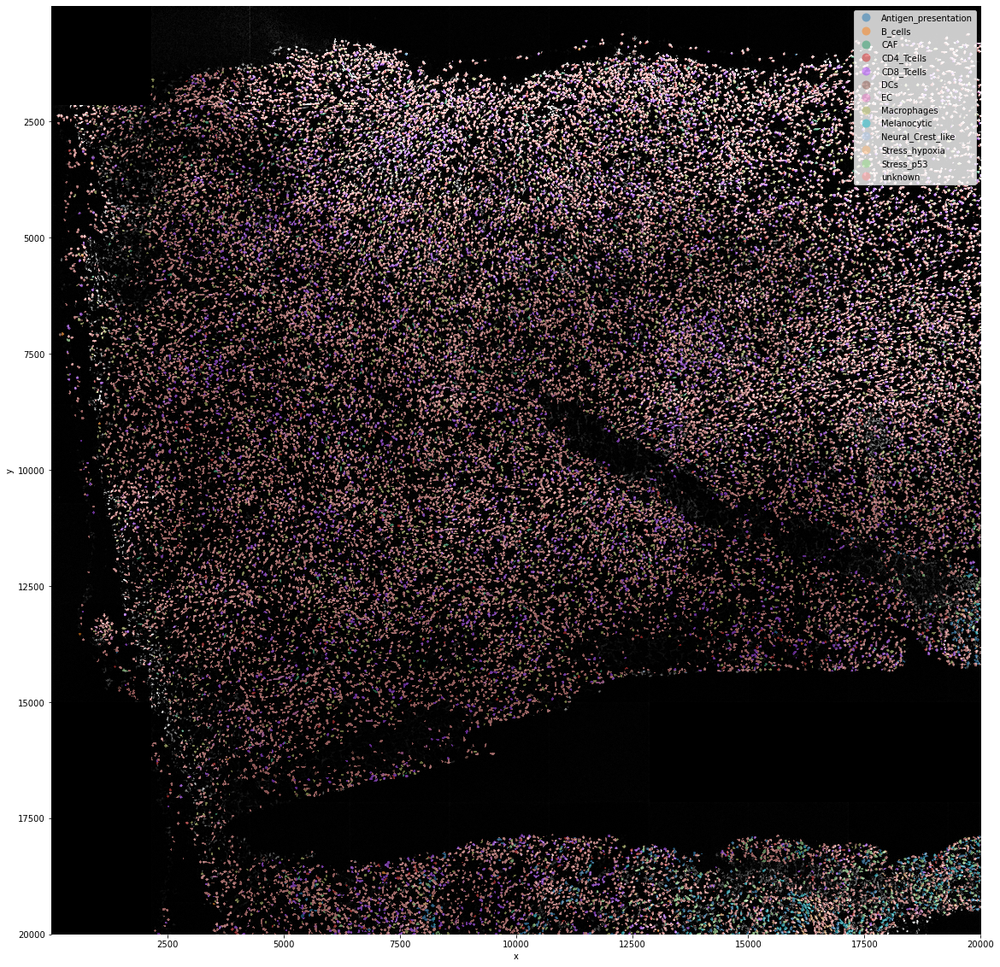

In [30]:
plot_shapes(sdata,column='annot',crd=[0,20000,0,20000])

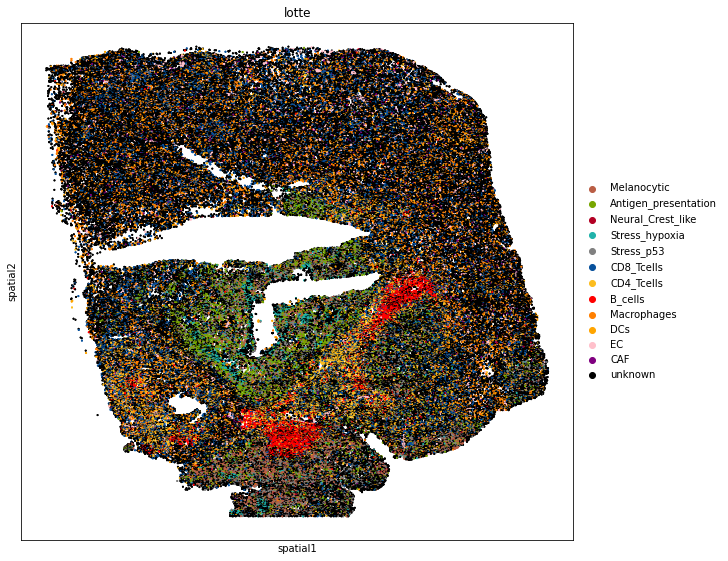

In [31]:
order_list = ['Melanocytic', 'Antigen_presentation', 'Neural_Crest_like', 'Stress_hypoxia', 'Stress_p53','CD8_Tcells', 'CD4_Tcells', 'B_cells','Macrophages', 'DCs','EC', 'CAF','unknown'] 

cat_type = pd.CategoricalDtype(categories=order_list, ordered=True)
sdata.table.obs['annot'] = sdata.table.obs['annot'].astype(cat_type)
sdata.table.obs['annot'] = sdata.table.obs['annot'].cat.reorder_categories(order_list)

import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
palette = {
   'Melanocytic': '#ba5e45',
    'Antigen_presentation': '#77a600',
    'Neural_Crest_like': '#b30024',
    'Stress_hypoxia': '#20b2aa',
    'Stress_p53': 'grey',
    'CD8_Tcells': '#08519c',
    'CD4_Tcells': '#fcbd1f',
    'B_cells': 'red',
    'Macrophages': '#ff7f00',
    'DCs': 'orange',
    'CAF': 'Purple',
    'EC': 'pink',
    'unknown':'black',
}


# Create a list of colors from the palette dictionary
colors = [palette[key] for key in sdata.table.obs.annot.cat.categories]
sdata.table.uns['annot_colors']=colors
# Create the ListedColormap
cmap = ListedColormap(colors)


sq.pl.spatial_scatter(
    sdata.table,
    color=['annot'],
    size=4,
    cmap='Reds',
    img=False,
    shape=None,
    figsize=(10, 10), save = "Slide1_GC55_spatial_with_UNKNOWN.pdf"

)


In [32]:
adata=sdata.table[np.where(sdata.table.obs.annot!='unknown')]
colors = [palette[key] for key in adata.obs.annot.cat.categories]
adata.uns['annot_colors']=colors

/var/folders/rk/0rnwtpxx53j_nv5l3xtmz0792832ql/T/ipykernel_67622/2629396554.py:3: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['annot_colors']=colors


In [33]:
colors

['#ba5e45',
 '#77a600',
 '#b30024',
 '#20b2aa',
 'grey',
 '#08519c',
 '#fcbd1f',
 'red',
 '#ff7f00',
 'orange',
 'pink',
 'Purple']

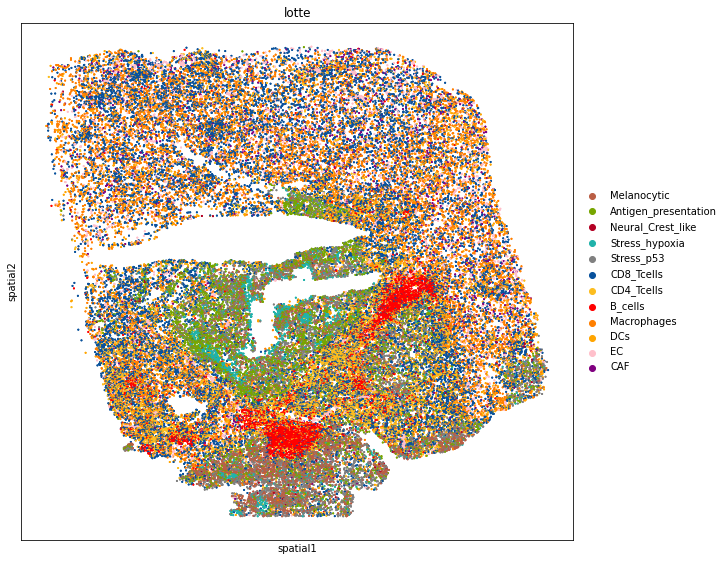

In [34]:
sq.pl.spatial_scatter(
    adata,
    color=['annot'],
    size=4,
    img=False,
    shape=None,
    figsize=(10, 10), save = "Slide1_GC55_spatial.pdf"

)


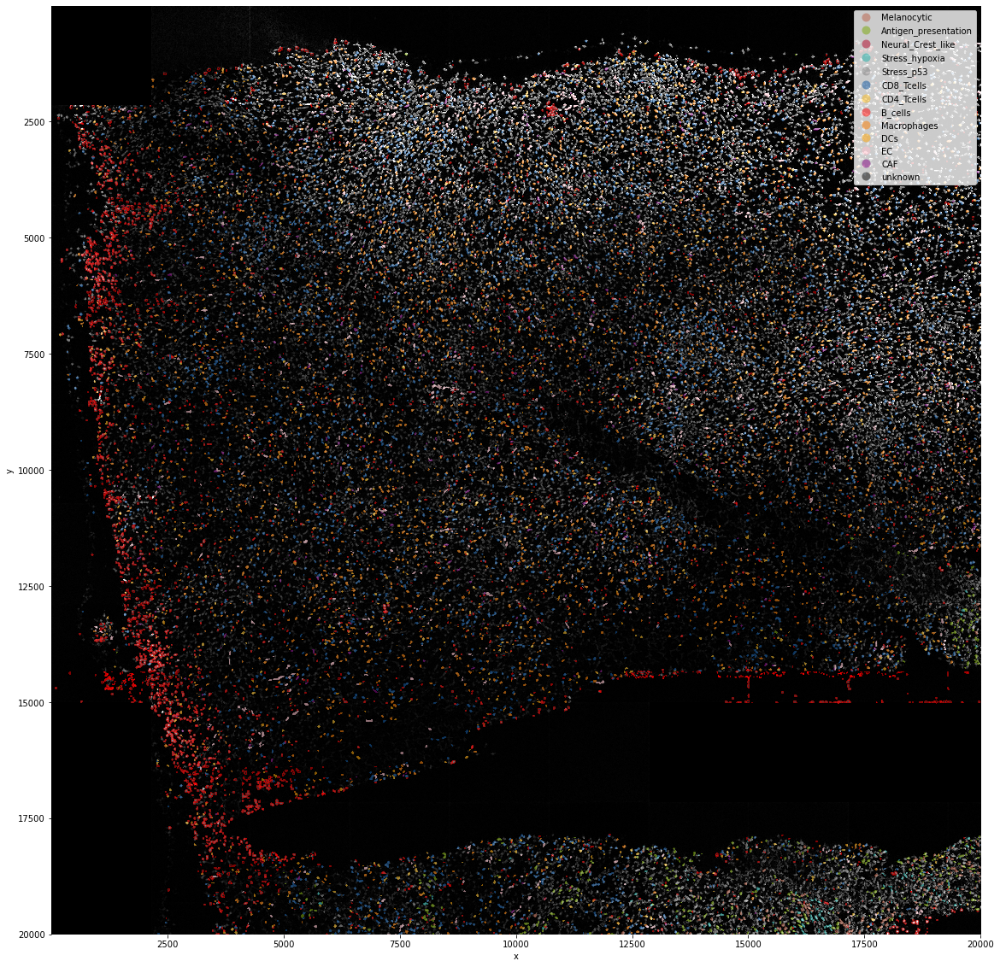

In [35]:
plot_shapes(sdata,column='annot',crd=[0,20000,0,20000],plot_filtered=True)

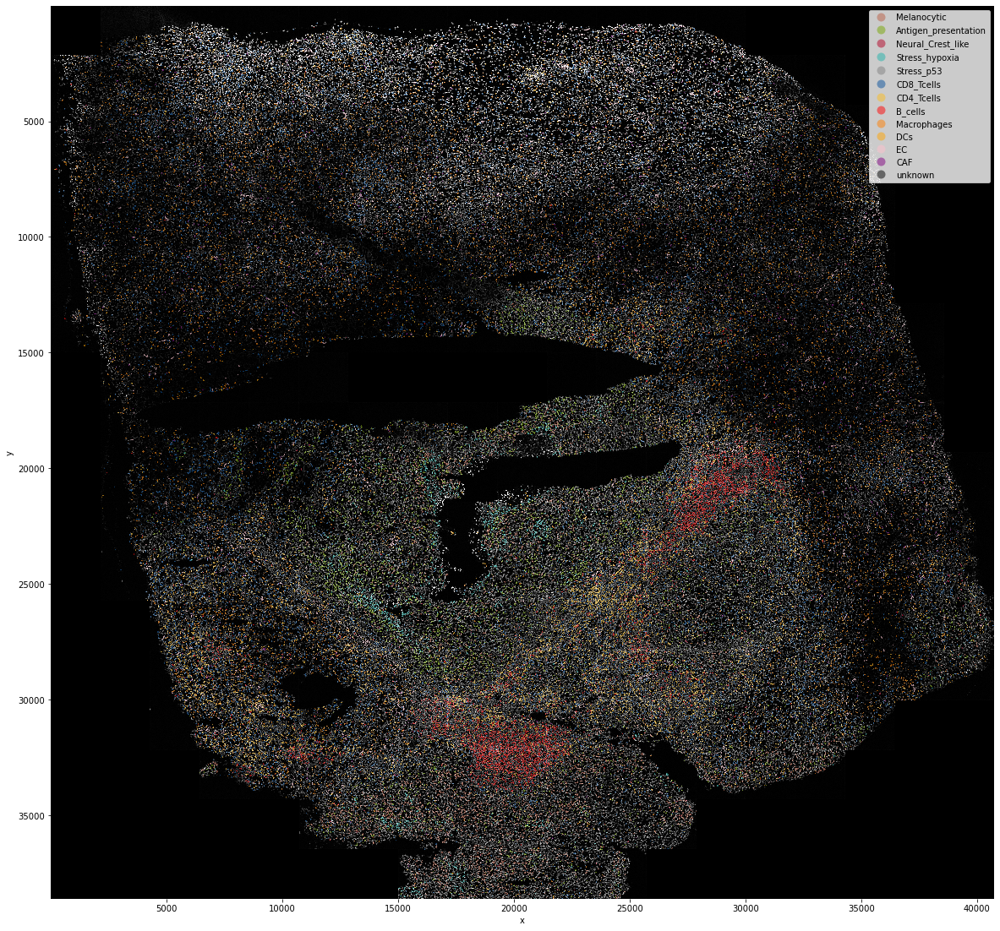

In [36]:
plot_shapes(sdata,column='annot')

  0%|          | 0/1000 [00:00<?, ?/s]

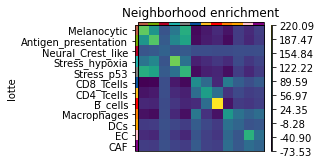

In [37]:
adata = adata[~adata.obs['annot'].isnull()]

sq.gr.spatial_neighbors(adata)
sq.gr.nhood_enrichment(adata, cluster_key="annot")
sq.pl.nhood_enrichment(adata, cluster_key="annot", save = "Slide1_GC55_heatmap.pdf", figsize = (2,2))


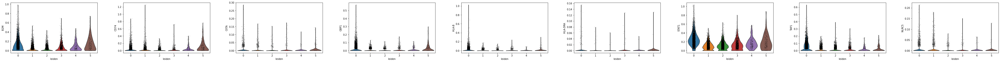

In [38]:
sc.pl.violin(MALIGNANT, keys=["B2M","CD74","CIITA","GBP1","HLA-B","HLA-DRA","STAT1","TAP1","NLRC5"], groupby="leiden")


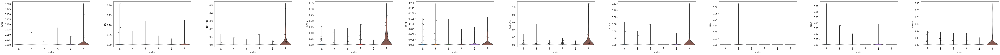

In [39]:
sc.pl.violin(MALIGNANT, keys=['DCN','ID3','PDGFRB','PRRX1','TCF4','COL1A1','COL5A1','LUM','THY1', 'POSTN'], groupby="leiden")

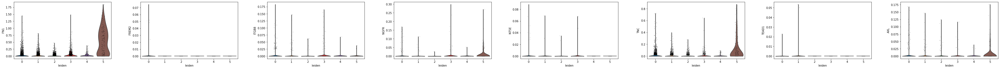

In [40]:
sc.pl.violin(MALIGNANT, keys=['FN1','FREM2','ITGB8','NGFR','NT5E','TNC', 'TEAD1', 'AXL'], groupby="leiden")

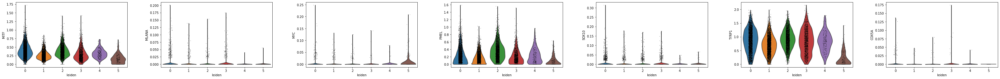

In [41]:
sc.pl.violin(MALIGNANT, keys=["MITF","MLANA","MYC","PMEL","SOX10","TYRP1","COX5A"], groupby="leiden")

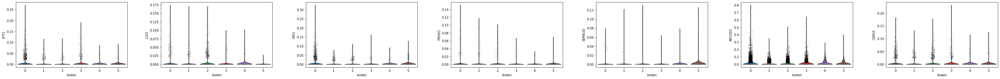

In [42]:
sc.pl.violin(MALIGNANT, keys=["IFIT1","LGI3","MX1","PKHD1","SEMA3D", "APCDD1", "CSPG5"], groupby="leiden")

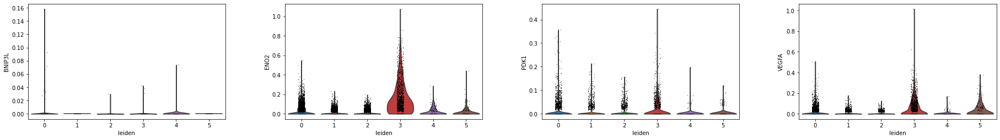

In [43]:
sc.pl.violin(MALIGNANT, keys=['BNIP3L','ENO2','PDK1','VEGFA'], groupby="leiden")


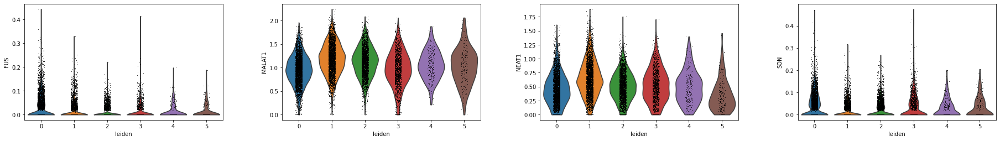

In [44]:
sc.pl.violin(MALIGNANT, keys=['FUS','MALAT1','NEAT1','SON'], groupby="leiden")

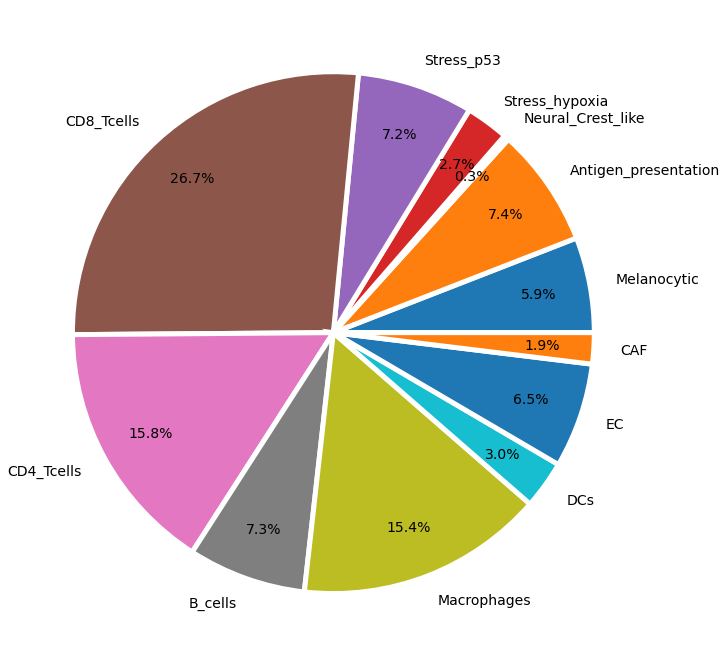

In [45]:
import matplotlib.pyplot as plt
number_of_cells = adata.obs.groupby(['annot']).apply(len)
cells_per_cluster_per = number_of_cells.div(adata.n_obs)*100

#cells_per_cluster_per = cells_per_cluster_per.to_frame(name='percentage')
#cells_per_cluster_per

label = list(cells_per_cluster_per.index)
fig = plt.gcf()
fig.set_size_inches(12,12)
plt.pie(cells_per_cluster_per, labels=label, 
     autopct='%.1f%%', pctdistance = 0.8,wedgeprops={'linewidth': 5.0, 'edgecolor': 'white'}, textprops={'fontsize': 14})
plt.savefig("Slide1_GC55_pie_TME.pdf", format="pdf", bbox_inches="tight")
plt.show()

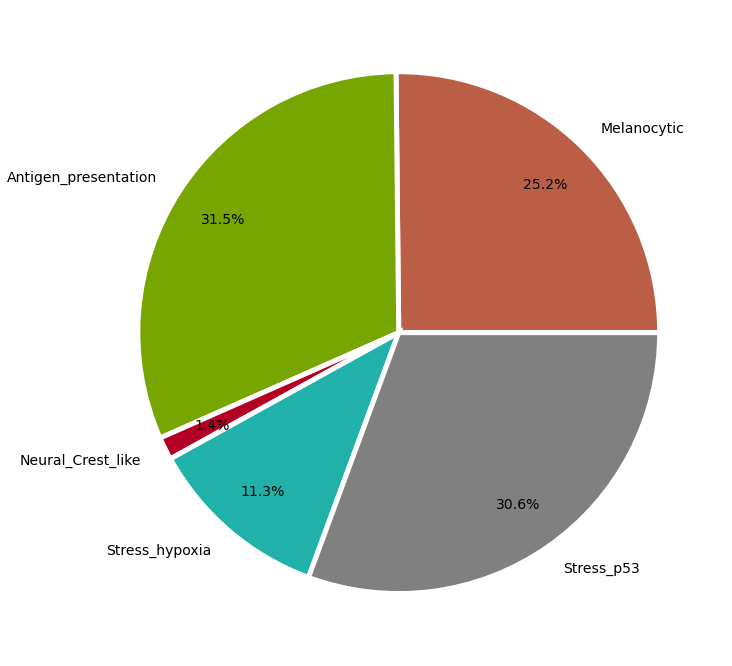

In [46]:
#sdata.table_FINAL.obs['Cell_percentage'] <- 
#25994
order_list = ['Melanocytic', 'Antigen_presentation', 'Neural_Crest_like', 'Stress_hypoxia', 'Stress_p53'] 

cat_type = pd.CategoricalDtype(categories=order_list, ordered=True)
MALIGNANT.obs['Malignant_clusters'] = MALIGNANT.obs['Malignant_clusters'].astype(cat_type)
MALIGNANT.obs['Malignant_clusters'] = MALIGNANT.obs['Malignant_clusters'].cat.reorder_categories(order_list)

import matplotlib.pyplot as plt
number_of_cells = MALIGNANT.obs.groupby(['Malignant_clusters']).apply(len)
cells_per_cluster_per = number_of_cells.div(MALIGNANT.n_obs)*100

#cells_per_cluster_per = cells_per_cluster_per.to_frame(name='percentage')
#cells_per_cluster_per

palette = {
    'Melanocytic': '#ba5e45',
    'Antigen_presentation': '#77a600',
    'Neural_Crest_like': '#b30024',
    'Stress_hypoxia': '#20b2aa',
    'Stress_p53': 'grey',
}

# Create a list of colors from the palette dictionary
colors = [palette[key] for key in palette]

label = list(cells_per_cluster_per.index)
fig = plt.gcf()
fig.set_size_inches(12,12)
plt.pie(cells_per_cluster_per, labels=label, 
     autopct='%.1f%%', pctdistance = 0.8,wedgeprops={'linewidth': 5.0, 'edgecolor': 'white'}, textprops={'fontsize': 14}, colors = colors)
plt.savefig("Slide1_GC55_pie_MALIGNANT.pdf", format="pdf", bbox_inches="tight")

plt.show()


